## Limpiando los datos / Cleaning data

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,0)

# Leer los datos
df = pd.read_csv(r'C:\Users\Marco\Google Drive\Data Analysis\Portfolio\03. Python\movies.csv')


In [2]:
# Echar un vistazo a los datos
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [3]:
# Buscar si faltan datos
# Checking if there's data missing in the df

for col in df.columns:
    porc_faltante = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, porc_faltante))

name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [4]:
# Reemplazar valores faltantes por cero
# Replacing missing values by zero

df = df.fillna(0)

In [5]:
# Verificar si aún faltan datos
# Checking if there's still data missing in the df

for col in df.columns:
    porc_faltante = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, porc_faltante))

name - 0.0%
rating - 0.0%
genre - 0.0%
year - 0.0%
released - 0.0%
score - 0.0%
votes - 0.0%
director - 0.0%
writer - 0.0%
star - 0.0%
country - 0.0%
budget - 0.0%
gross - 0.0%
company - 0.0%
runtime - 0.0%


In [6]:
# Ver los tipos de datos de las columnas
df.dtypes


name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [7]:
# Cambiar el tipo de data de una columna (float a int)
# Change data type of a column

df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')

In [8]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,0,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,0,0,90.0
7664,Dream Round,0,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,0,0,Cactus Blue Entertainment,90.0
7665,Saving Mbango,0,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,0,Embi Productions,0.0
7666,It's Just Us,0,Drama,2020,"October 1, 2020 (United States)",0.0,0.0,James Randall,James Randall,Christina Roz,United States,15000,0,0,120.0


## Extracting data from a column

In [60]:
#Reading a copy of the same DF to work on a extracting data from a column - example

df2 = pd.read_csv(r'C:\Users\Marco\Google Drive\Data Analysis\Portfolio\03. Python\movies2.csv')

In [12]:
df2

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0


In [13]:
# Extraer año que está dentro de la columna "released"
# Extracting year inside "released" column

entredossimb = df2['released'].str.split(', ').str[1]
entredossimb = entredossimb.str.split('(').str[0]

In [14]:
df2['entredossimb'] = entredossimb

In [15]:
df2['entredossimb'] = df2['entredossimb'].str.strip()

In [16]:
df2['entredossimb'] = df2['entredossimb'].fillna(0)

In [17]:
df2['entredossimb'] = df2['entredossimb'].astype(int)

In [18]:
df2['year_released_extracted'] = df2['entredossimb']

In [19]:
df2

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,entredossimb,year_released_extracted
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0,1980,1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0,1980,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0,1980,1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0,1980,1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0,1980,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0,2020,2020
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0,2020,2020
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN,2020,2020
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0,2020,2020


In [20]:
# Eliminar columna en que se trabajó los datos
# Deleting column used to work the data

del df2['entredossimb']

In [21]:
# Copiando columna nueva a df original (desde df2)
# Copying new column to original df (from df2)

df['year_released_extracted'] = df2['year_released_extracted']

In [22]:
# Checking the datatype of the column 'year_released_extracted'
# Verificando el tipo de datos de la columna 'year_released_extracted'

df['year_released_extracted'].dtype

dtype('int32')

In [23]:
# Mostrar el total de las filas
# Showing all the rows

pd.set_option('display.max_rows', None)

In [24]:
# Ordenar los datos por ganancias
# Ordering data by revenue

#df.sort_values(by=['gross'], inplace=False, ascending=False)

In [25]:
# Convirtiendo 'gross' de Float a Int

df['gross'] = df['gross'].fillna(0)
df['gross'] = df['gross'].astype('int64')

In [26]:
# Convirtiendo 'gross' de Float a Int

df['budget'] = df['budget'].fillna(0)
df['budget'] = df['budget'].astype('int64')

## Correlación / Correlation

Haremos algunas suposiciones hipotéticas (con fines ejemplificativos):

Let's assume -hypothetically- (just to set an example):

***
1. "A medida que el presupuesto (budget) para cada película fue más grande, las ganancias (gross) también fue mayor."


As the budget was bigger for each movie, gross income was also bigger.
***

2. "La compañía productora también tiene una gran correlación con las ganancias."

The company that produced the movie had a great correlation with gross.

***

### Crear un Scatter  plot Budget vs Gross

### Creating a Scatter plot Budget vs Gross

In [27]:
df['budget'] = df['budget'].fillna(1)
df['budget'].astype('int64')

0        19000000
1         4500000
2        18000000
3         3500000
4         6000000
5          550000
6        27000000
7        18000000
8        54000000
9        10000000
10       15000000
11        5000000
12       20000000
13        6000000
14        6500000
15        5100000
16              0
17       10000000
18        1000000
19              0
20       11000000
21       44000000
22       12000000
23       20000000
24              0
25              0
26              0
27       36000000
28        9000000
29        4800000
30              0
31              0
32              0
33        5100000
34              0
35       10000000
36        4000000
37        3000000
38              0
39              0
40              0
41              0
42        3500000
43              0
44              0
45              0
46       22000000
47         300000
48       15000000
49       35000000
50       10000000
51        7000000
52       20000000
53        6500000
54              0
55        

In [28]:
df['gross'] = df['gross'].fillna(1)
df['gross'].astype('int64')

0         46998772
1         58853106
2        538375067
3         83453539
4         39846344
5         39754601
6        115229890
7         23402427
8        108185706
9         15795189
10        70687344
11        30031783
12        49823037
13        54766923
14        31899000
15         9709597
16        21202829
17       103300686
18        21448782
19       101300000
20        19814523
21         3484523
22        16647800
23        22762571
24        46918287
25        19853892
26        34326249
27               0
28        37121708
29        22743674
30        22482952
31        14796236
32        66132626
33          534816
34        43995918
35        69847348
36        10000000
37         6342668
38        27118000
39        67182787
40         5000000
41               0
42         7063886
43         6659377
44         8415112
45        41675194
46        15716828
47               0
48        14662035
49               0
50        10389003
51         4309490
52          

In [29]:
df.sort_values(by=['gross'], inplace=False, ascending=True)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_released_extracted
7667,Tee em el,0,Horror,2020,"August 19, 2020 (United States)",5.7,7.0,Pereko Mosia,Pereko Mosia,Siyabonga Mabaso,South Africa,0,0,PK 65 Films,102.0,2020
980,Malcolm,PG-13,Comedy,1986,"November 5, 1986 (United States)",7.1,2100.0,Nadia Tass,David Parker,Colin Friels,Australia,0,0,Cascade Films,85.0,1986
261,Frances,R,Biography,1982,"March 11, 1983 (Australia)",7.3,7300.0,Graeme Clifford,Eric Bergren,Jessica Lange,United States,0,0,Brooksfilms,140.0,1983
1822,The Shrimp on the Barbie,PG-13,Comedy,1990,"August 31, 1990 (United States)",5.7,1200.0,Director,Grant Morris,Cheech Marin,Australia,0,0,Unity Pictures,90.0,1990
460,Young Warriors,R,Action,1983,"August 28, 1983 (United States)",4.7,460.0,Lawrence David Foldes,Russell W. Colgin,Ernest Borgnine,United States,0,0,Star Cinema,105.0,1983
1367,Jack's Back,R,Crime,1988,"May 6, 1988 (United States)",5.9,3000.0,Rowdy Herrington,Rowdy Herrington,James Spader,United States,1000000,0,Cinema Group,97.0,1988
988,Killer Party,R,Comedy,1986,"May 9, 1986 (United States)",5.1,1800.0,William Fruet,Barney Cohen,Martin Hewitt,Canada,0,0,Marquis,91.0,1986
462,Hanna K.,R,Drama,1983,"September 7, 1983 (France)",6.3,661.0,Costa-Gavras,Franco Solinas,Jill Clayburgh,Israel,0,0,K.G. Productions,111.0,1983
464,White Star,0,Drama,1983,"March 8, 1985 (West Germany)",6.0,235.0,Roland Klick,Karen Jaehne-Lathan,Dennis Hopper,West Germany,100000,0,0,92.0,1985
1825,Strangers in Good Company,PG,Drama,1990,1990 (Canada),7.7,995.0,Cynthia Scott,Gloria Demers,Alice Diabo,Canada,0,0,National Film Board of Canada (NFB),101.0,0


In [28]:
df['budget'] = df['budget'].replace(0, 1)
df['budget']

0        19000000
1         4500000
2        18000000
3         3500000
4         6000000
5          550000
6        27000000
7        18000000
8        54000000
9        10000000
10       15000000
11        5000000
12       20000000
13        6000000
14        6500000
15        5100000
16              1
17       10000000
18        1000000
19              1
20       11000000
21       44000000
22       12000000
23       20000000
24              1
25              1
26              1
27       36000000
28        9000000
29        4800000
30              1
31              1
32              1
33        5100000
34              1
35       10000000
36        4000000
37        3000000
38              1
39              1
40              1
41              1
42        3500000
43              1
44              1
45              1
46       22000000
47         300000
48       15000000
49       35000000
50       10000000
51        7000000
52       20000000
53        6500000
54              1
55        

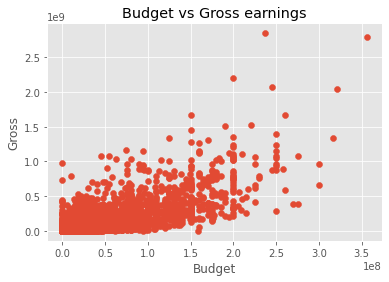

In [30]:

%matplotlib inline
plt.scatter(x = df['budget'], y = df['gross'])

plt.title('Budget vs Gross earnings')

plt.xlabel('Budget')

plt.ylabel('Gross')

plt.show()



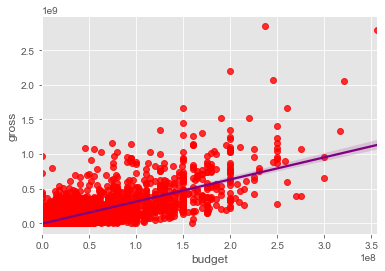

In [31]:
# Plot budget vs gross Seaborn

sns.regplot(x ='budget', y ='gross', data = df, scatter_kws={"color":"red"}, line_kws={"color":"purple"})
sns.set(rc={'figure.figsize':(11.7,8.27)})

## Buscar correlación con método Pearson

## Searching correlation with Pearson method

**Correlation**

The correlation coefficient is a number between -1 and 1 (inclusive) that measures the "relatedness" of the numbers in the samples. A coefficient of 1 indicates a direct relationship in which all points are linearly related on a line with positive slope. (MIT, 1999)

### Pearson Correlation

In [32]:
df.corr(method = 'pearson')

,year,score,votes,budget,gross,runtime,year_released_extracted
year,1.000000,0.092616,0.222427,0.309212,0.261900,0.116358,0.143738
score,0.092616,1.000000,0.407101,0.056863,0.186012,0.394564,0.001132
votes,0.222427,0.407101,1.000000,0.486931,0.632870,0.306984,0.056025
budget,0.309212,0.056863,0.486931,1.000000,0.750157,0.268372,0.073969
gross,0.261900,0.186012,0.632870,0.750157,1.000000,0.244339,0.056556
runtime,0.116358,0.394564,0.306984,0.268372,0.244339,1.000000,0.043666
year_released_extracted,0.143738,0.001132,0.056025,0.073969,0.056556,0.043666,1.000000


#### Alta correlación entre Budget y Gross
#### High correlation Budget - Gross

<function matplotlib.pyplot.show(close=None, block=None)>

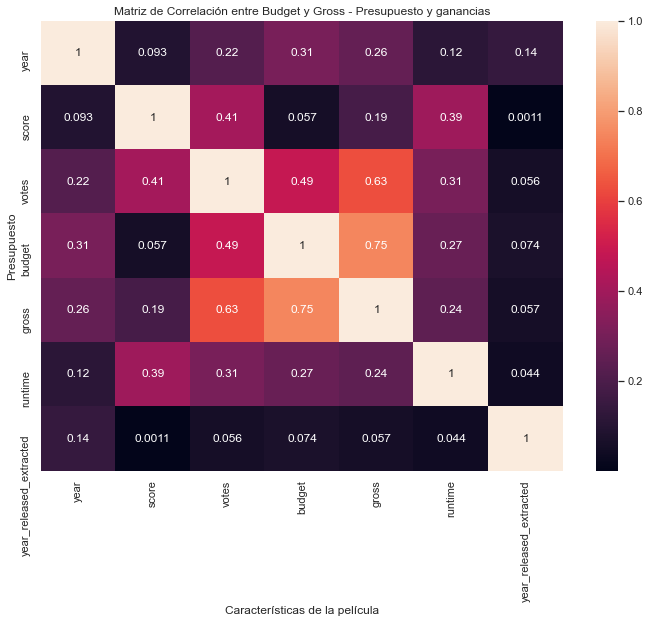

In [33]:
correlation_matrix = df.corr(method='pearson')

sns.heatmap(correlation_matrix, annot=True)

plt.title('Matriz de Correlación entre Budget y Gross - Presupuesto y ganancias')
plt.xlabel('Características de la película')
plt.ylabel('Presupuesto')

plt.show

### Correlation to Company

Primero cambiamos las compañías a números para poder correlacionarlos con ganancias.

We first change the value company to numbers so we can correlate it to earnings.

In [34]:
df_numero = df

# We use a for loop to loop through all the columns with type "object" (using an if statement)
# If the column has datatype object, then we convert it to "Category data type" using astype
# Finally, after converting to "category" we assign a code for each cat.


for col_name in df_numero.columns:
    if(df_numero[col_name].dtype == 'object'):
        df_numero[col_name] = df_numero[col_name].astype('category')
        df_numero[col_name] = df_numero[col_name].cat.codes
        
df_numero
        
        

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_released_extracted
0,6587,7,6,1980,1706,8.4,927000.0,2589,4015,1048,55,19000000,46998772,2320,146.0,1980
1,5573,7,1,1980,1493,5.8,65000.0,2269,1633,328,56,4500000,58853106,732,104.0,1980
2,5142,5,0,1980,1772,8.7,1200000.0,1111,2568,1746,56,18000000,538375067,1541,124.0,1980
3,286,5,4,1980,1493,7.7,221000.0,1301,2001,2247,56,3500000,83453539,1813,88.0,1980
4,1027,7,4,1980,1544,7.3,108000.0,1054,522,411,56,6000000,39846344,1778,98.0,1980
5,2109,7,10,1980,2503,6.4,123000.0,2528,4363,242,56,550000,39754601,1813,95.0,1980
6,5574,7,0,1980,1772,7.9,188000.0,1412,839,1278,56,27000000,115229890,2282,133.0,1980
7,4436,7,3,1980,700,8.2,330000.0,1829,1770,2241,56,18000000,23402427,632,129.0,1980
8,5281,5,0,1980,1754,6.8,101000.0,2306,1980,878,56,54000000,108185706,884,127.0,1981
9,6213,7,3,1980,2287,7.0,10000.0,2864,424,590,56,10000000,15795189,2273,100.0,1980


Como podemos ver, columnas como Genre, director, writer, cambiaron a valores numéricos.

As we can see, columns such as Genre, director, writer, changed to numeric values.

In [35]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_released_extracted
0,6587,7,6,1980,1706,8.4,927000.0,2589,4015,1048,55,19000000,46998772,2320,146.0,1980
1,5573,7,1,1980,1493,5.8,65000.0,2269,1633,328,56,4500000,58853106,732,104.0,1980
2,5142,5,0,1980,1772,8.7,1200000.0,1111,2568,1746,56,18000000,538375067,1541,124.0,1980
3,286,5,4,1980,1493,7.7,221000.0,1301,2001,2247,56,3500000,83453539,1813,88.0,1980
4,1027,7,4,1980,1544,7.3,108000.0,1054,522,411,56,6000000,39846344,1778,98.0,1980
5,2109,7,10,1980,2503,6.4,123000.0,2528,4363,242,56,550000,39754601,1813,95.0,1980
6,5574,7,0,1980,1772,7.9,188000.0,1412,839,1278,56,27000000,115229890,2282,133.0,1980
7,4436,7,3,1980,700,8.2,330000.0,1829,1770,2241,56,18000000,23402427,632,129.0,1980
8,5281,5,0,1980,1754,6.8,101000.0,2306,1980,878,56,54000000,108185706,884,127.0,1981
9,6213,7,3,1980,2287,7.0,10000.0,2864,424,590,56,10000000,15795189,2273,100.0,1980


<function matplotlib.pyplot.show(close=None, block=None)>

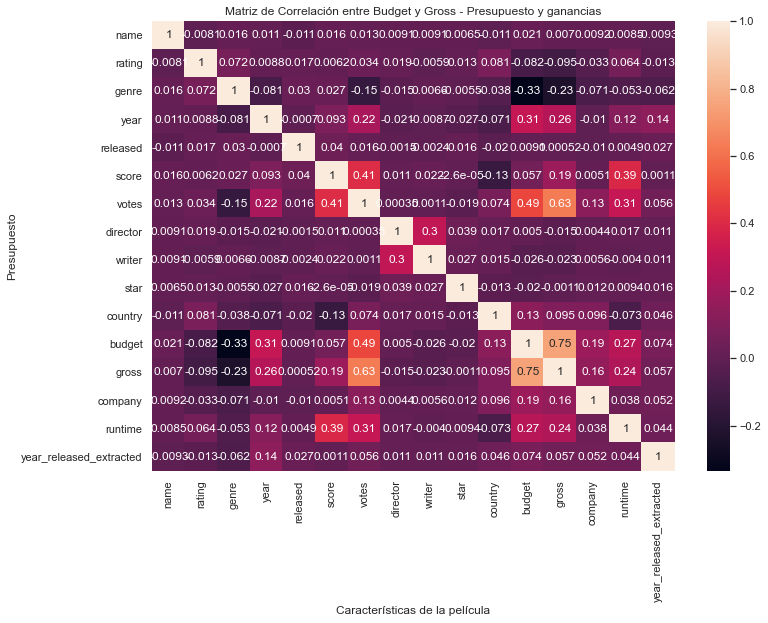

In [36]:
correlation_matrix = df_numero.corr(method='pearson')

sns.heatmap(correlation_matrix, annot=True)

plt.title('Matriz de Correlación entre Budget y Gross - Presupuesto y ganancias')
plt.xlabel('Características de la película')
plt.ylabel('Presupuesto')

plt.show

Ahora tenemos una representación numérica de todos los campos, podemos observar una correlación entre Gross y cualquier otro valor, como la correlación entre compañía e ingresos, por ejemplo.

Now that we have a numeric representation for each value, we can check the correlation between Gross and any value, such as the correlation between company and gross, for example.

In [38]:
df_numero.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_released_extracted
name,1.000000,-0.008069,0.016355,0.011453,-0.011311,0.016377,0.013038,0.009079,0.009081,0.006472,-0.010737,0.020548,0.006989,0.009211,0.008483,-0.009264
rating,-0.008069,1.000000,0.072423,0.008779,0.016613,0.006192,0.033743,0.019483,-0.005921,0.013405,0.081244,-0.081939,-0.095450,-0.032943,0.064133,-0.013129
genre,0.016355,0.072423,1.000000,-0.081261,0.029822,0.027384,-0.145296,-0.015258,0.006567,-0.005477,-0.037615,-0.334021,-0.234297,-0.071067,-0.052914,-0.061689
year,0.011453,0.008779,-0.081261,1.000000,-0.000695,0.092616,0.222427,-0.020795,-0.008656,-0.027242,-0.070938,0.309212,0.261900,-0.010431,0.116358,0.143738
released,-0.011311,0.016613,0.029822,-0.000695,1.000000,0.039814,0.015878,-0.001478,-0.002404,0.015777,-0.020427,0.009145,0.000519,-0.010474,0.004852,0.026875
score,0.016377,0.006192,0.027384,0.092616,0.039814,1.000000,0.407101,0.010568,0.022098,-0.000026,-0.133346,0.056863,0.186012,0.005081,0.394564,0.001132
votes,0.013038,0.033743,-0.145296,0.222427,0.015878,0.407101,1.000000,0.000349,0.001127,-0.019146,0.073525,0.486931,0.632870,0.133457,0.306984,0.056025
director,0.009079,0.019483,-0.015258,-0.020795,-0.001478,0.010568,0.000349,1.000000,0.299067,0.039234,0.017490,0.004976,-0.014916,0.004404,0.017062,0.010682
writer,0.009081,-0.005921,0.006567,-0.008656,-0.002404,0.022098,0.001127,0.299067,1.000000,0.027245,0.015343,-0.025911,-0.022997,0.005646,-0.004036,0.011463
star,0.006472,0.013405,-0.005477,-0.027242,0.015777,-0.000026,-0.019146,0.039234,0.027245,1.000000,-0.012998,-0.019952,-0.001129,0.012442,0.009418,0.016025


#### Ordenemos toda la matriz para facilitar su análisis

#### Let's sort the matrix to make the analysis easier

In [42]:
correlacion_matriz = df_numero.corr() # We create a variable out of the correlation, called correlacion_matriz
pares = correlacion_matriz.unstack() # Next, we make a new variable called pares, this time we apply the method unstack to the variable correlacion_matriz

pares_ordenados = pares.sort_values() # Finally, we create a last variable called pares_ordenados, applying the method sort_values to the variable pares
pares_ordenados


budget                   genre                     -0.334021
genre                    budget                    -0.334021
gross                    genre                     -0.234297
genre                    gross                     -0.234297
                         votes                     -0.145296
votes                    genre                     -0.145296
country                  score                     -0.133346
score                    country                   -0.133346
gross                    rating                    -0.095450
rating                   gross                     -0.095450
budget                   rating                    -0.081939
rating                   budget                    -0.081939
year                     genre                     -0.081261
genre                    year                      -0.081261
country                  runtime                   -0.073319
runtime                  country                   -0.073319
company                 

#### High correlation

In [59]:
corr_alta = pares_ordenados[(pares_ordenados) > 0.5] # Establishing a condition for the pairs, only the correlation higher to 0.5 would be considered high correlation.
corr_alta = corr_alta[(pares_ordenados) < 1.0] # Discarding the correlation of 1, because that's only the correlation of the value with itself, for example Budget vs Budget would be 1.

corr_alta

gross   votes     0.632870
votes   gross     0.632870
gross   budget    0.750157
budget  gross     0.750157
dtype: float64

### Conclusiones

### Conclusions

Podemos concluir que  *Votos* y  *Presupuesto*  son los elementos de una película (en nuestro Dataframe) que están más correlacionados con las *Ganancias*.

We can conclude that *Votes* and *Budget* are the elements of a movie (considering our DF) that are correlated to *Gross*